<a href="https://colab.research.google.com/github/AbrahamOtero/MLiB/blob/main/1_ImportAndExploreData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Importing and exploring data

##Set up

We import the libraries that we are going to need:

In [1]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

##Iris dataset

We read the Iris file; it is located in a directory of the GitHub repository:

In [2]:
url = 'https://raw.githubusercontent.com/AbrahamOtero/MLiB/main/datasets/iris.csv'

iris = pd.read_csv(url)

# Display the first rows of the DataFrame
print(iris.head())

   sepal.length  sepal.width  petal.length  petal.width   class
0           5.1          3.5           1.4          0.2  Setosa
1           4.9          3.0           1.4          0.2  Setosa
2           4.7          3.2           1.3          0.2  Setosa
3           4.6          3.1           1.5          0.2  Setosa
4           5.0          3.6           1.4          0.2  Setosa


Let's look at some information about the dataset; we can see that we have 150 instances and 5 columns, which correspond to 4 features (all of the real numbers, float64) and the class (text, object).

In [3]:
iris.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sepal.length  150 non-null    float64
 1   sepal.width   150 non-null    float64
 2   petal.length  150 non-null    float64
 3   petal.width   150 non-null    float64
 4   class         150 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.0+ KB


How many different values does the class has?

In [4]:
iris["class"].value_counts()

,count
class,
Setosa,50
Versicolor,50
Virginica,50


Let's calculate some statistics on the numerical attributes of the data set:

In [5]:
iris.describe()

,sepal.length,sepal.width,petal.length,petal.width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333
std,0.828066,0.435866,1.765298,0.762238
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


Let us also computte the skewes and kurtosis of the attributes:

In [6]:
# Skewes and Kurtosis

print("Skewness:\n", iris.skew(numeric_only=True))
print("\nKursosis:\n", iris.kurt(numeric_only=True))

Skewness:
 sepal.length    0.314911
sepal.width     0.318966
petal.length   -0.274884
petal.width    -0.102967
dtype: float64

Kursosis:
 sepal.length   -0.552064
sepal.width     0.228249
petal.length   -1.402103
petal.width    -1.340604
dtype: float64


And the correltaion matrix; we will also represent it as a heat map using the Seaborn library:

              sepal.length  sepal.width  petal.length  petal.width
sepal.length      1.000000    -0.117570      0.871754     0.817941
sepal.width      -0.117570     1.000000     -0.428440    -0.366126
petal.length      0.871754    -0.428440      1.000000     0.962865
petal.width       0.817941    -0.366126      0.962865     1.000000


<Axes: >

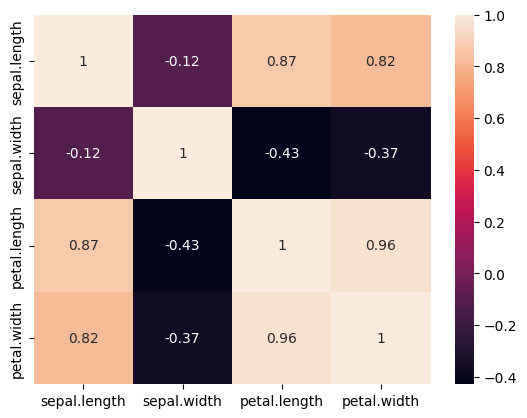

In [7]:
# We ignore non-numeric attributes
print(iris.corr(numeric_only=True))

sns.heatmap(iris.corr(numeric_only=True), annot=True)

Below we plot histograms of the features:

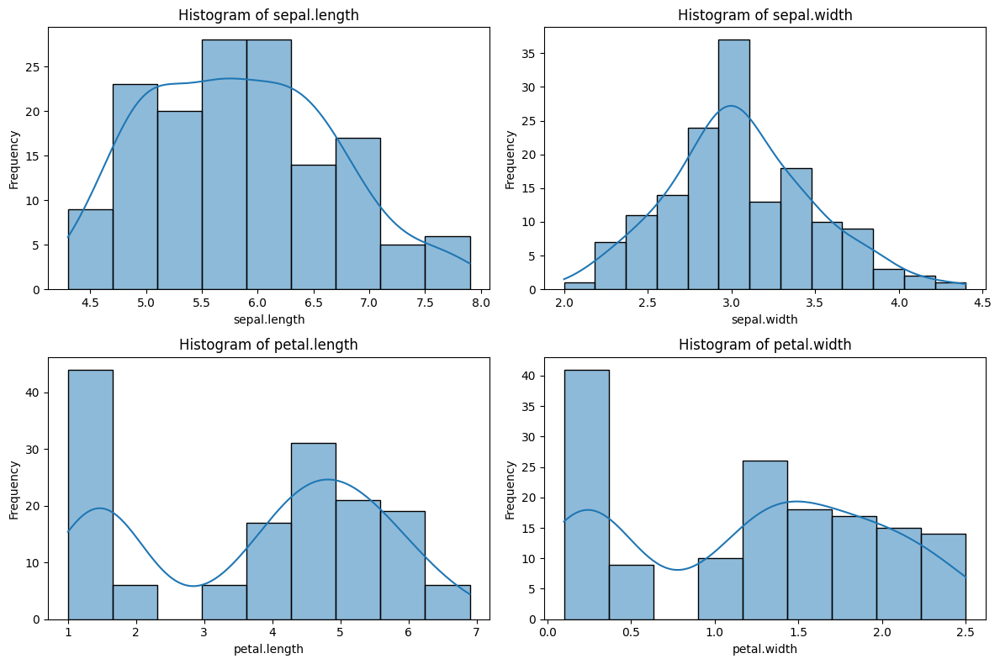

In [8]:
plt.figure(figsize=(12, 8))

# For each column in the dataset but hte last one (-1)
for i, feature in enumerate(iris.columns[:-1]):
    # Create a subplot in a 2x2 grid of plots
    plt.subplot(2, 2, i + 1)
    # kde=True and an estimate of the density distribution based on kernels
    sns.histplot(iris[feature], kde=True)
    plt.title(f'Histogram of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

Now we shall create the scatter plot matrix, colouring the instances based on the class:

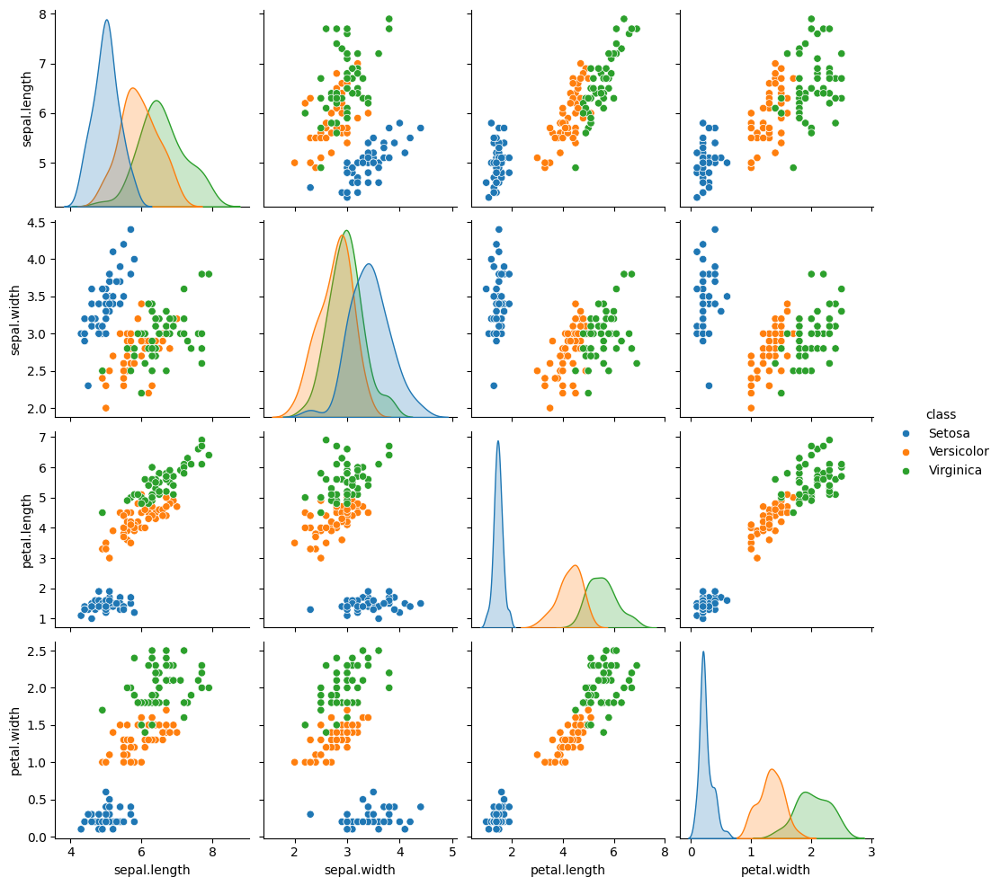

In [9]:
sns.pairplot(iris, hue='class')
plt.show()


Let us just plot one of the scatter plots:



<Axes: xlabel='petal.width', ylabel='sepal.length'>

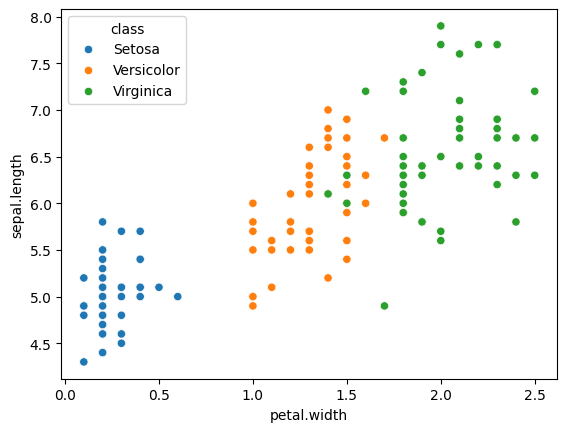

In [10]:

sns.scatterplot(x="petal.width", y="sepal.length", hue="class", data=iris)

Let us also plot a parallet plots. As a color attribute we must pass a list with as many integers as instances we have, and using a different integer value for each color (class) to be used.



In [11]:
import plotly.express as px

# Modifying the order of the dimensions we can generate different parallel plots
fig = px.parallel_coordinates(iris, color= iris['class'].astype('category').cat.codes,
                              dimensions=['sepal.length', 'sepal.width',
                                          'petal.length', 'petal.width'])
fig.show()


An a finally let us create box plots:

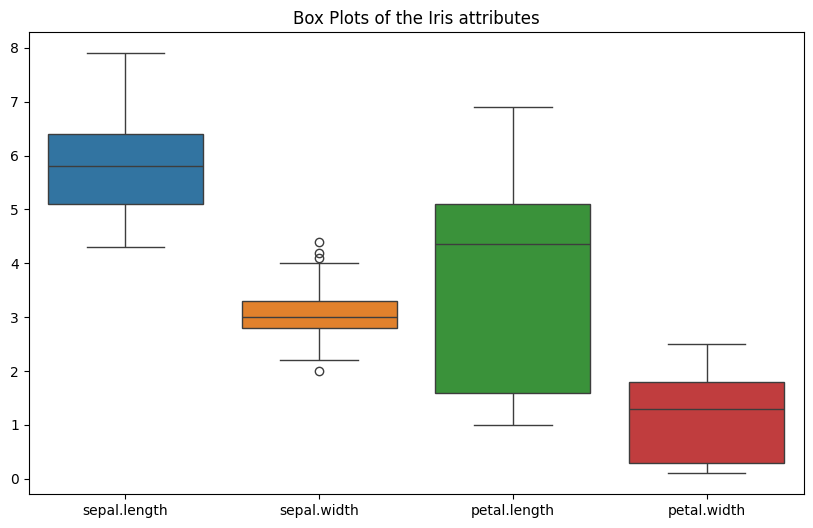

In [12]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=iris, orient='v')
plt.title('Box Plots of the Iris attributes')
plt.show()


##Golf dataset

Let's load the dataset and visualize  the golf dataset:

In [13]:
url = 'https://raw.githubusercontent.com/AbrahamOtero/MLiB/main/datasets/golf.csv'

golf = pd.read_csv(url)
print(golf)
golf.info()

     Outlook  Temp Humidity  Windy Play
0      Rainy   Hot     High  False   No
1      Rainy   Hot     High   True   No
2   Overcast   Hot     High  False  Yes
3      Sunny  Mild     High  False  Yes
4      Sunny  Cool   Normal  False  Yes
5      Sunny  Cool   Normal   True   No
6   Overcast  Cool   Normal   True  Yes
7      Rainy  Mild     High  False   No
8      Rainy  Cool   Normal  False  Yes
9      Sunny  Mild   Normal  False  Yes
10     Rainy  Mild   Normal   True  Yes
11  Overcast  Mild     High   True  Yes
12  Overcast   Hot   Normal  False  Yes
13     Sunny  Mild     High   True   No
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14 entries, 0 to 13
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Outlook   14 non-null     object
 1   Temp      14 non-null     object
 2   Humidity  14 non-null     object
 3   Windy     14 non-null     bool  
 4   Play      14 non-null     object
dtypes: bool(1), object(4)
memor

Let's look at the histogram of the attributes; on this occasion we will also represent the one for the class:

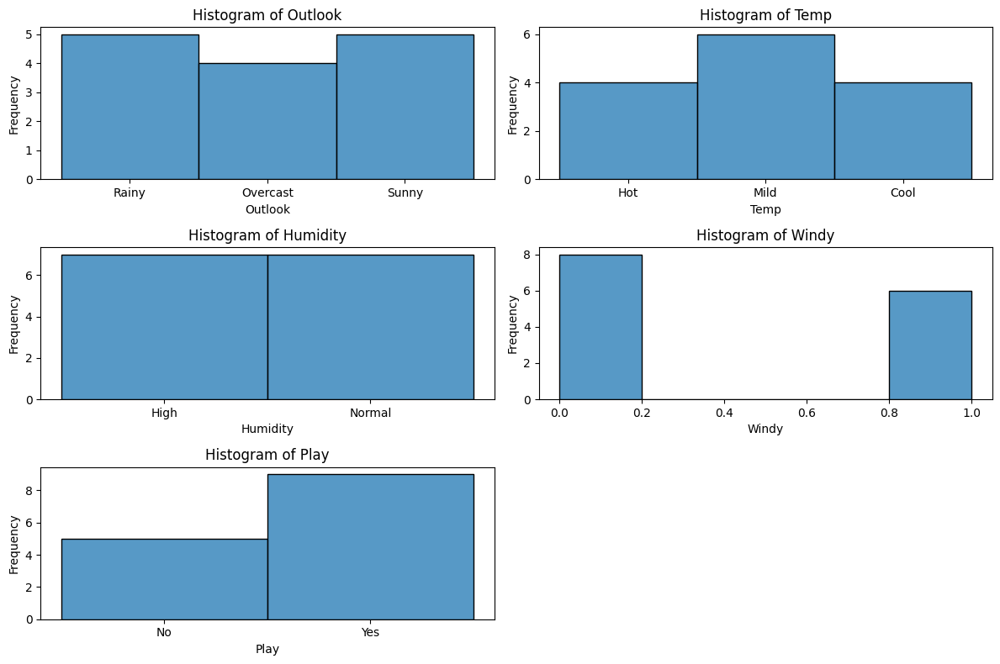

In [14]:
plt.figure(figsize=(12, 8))
for i, feature in enumerate(golf.columns):
    plt.subplot(3, 2, i + 1)
    sns.histplot(golf[feature])
    plt.title(f'Histogram of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


In this case all variables are nominal. We will have to transform them all into an integer if we want to make a scatter plot. The **cat.codes** attribute can used with pandas nominal attributes to transform them into a numerical attribute.

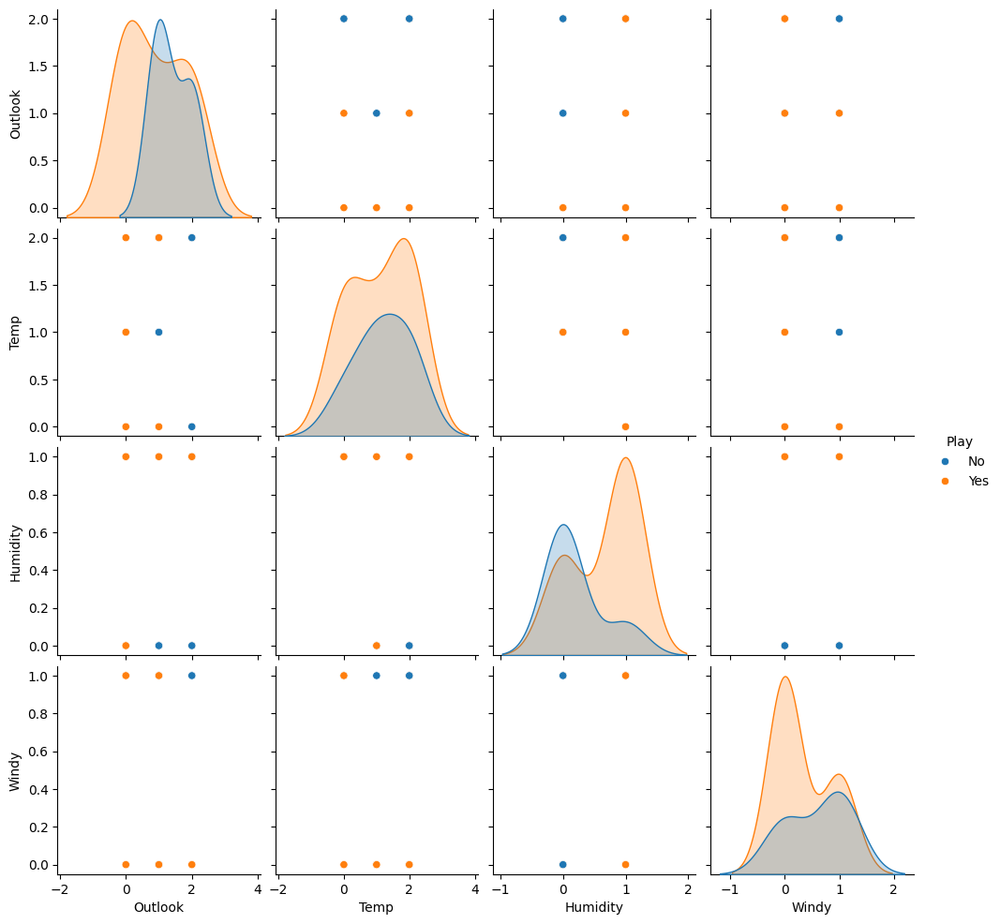

In [15]:
golf_scatter = golf.copy()
golf_scatter['Outlook'] = golf['Outlook'].astype('category').cat.codes
golf_scatter['Temp'] = golf['Temp'].astype('category').cat.codes
golf_scatter['Humidity'] = golf['Humidity'].astype('category').cat.codes
golf_scatter['Windy'] = golf['Windy'].astype('category').cat.codes

# Crear scatterplot
sns.pairplot(golf_scatter, hue='Play', diag_kind='kde')
plt.show()

Since the variables were nominal, this representation is not very useful. We do not know whether a point at a given position in the feature space represents a single instance, or multiple. We can add jitter by adding a small random number to each integer value we want to represent; this way we can see how many instances there are in each position of the grid.

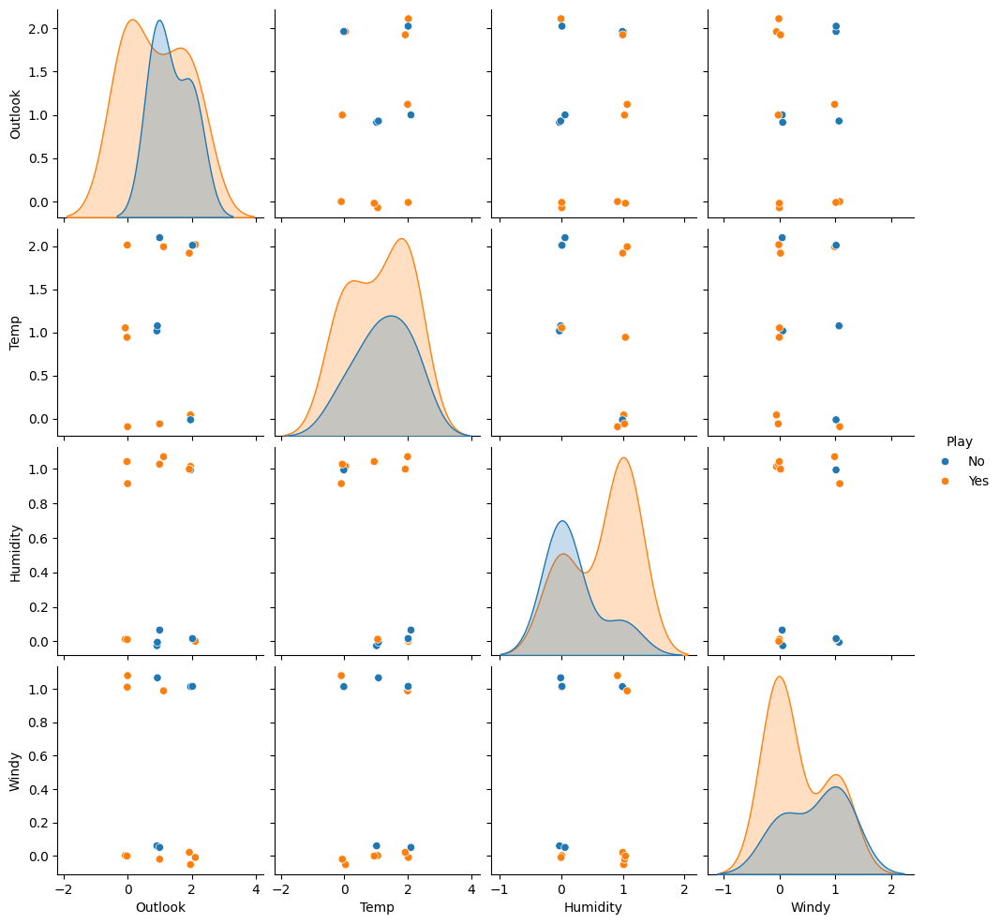

In [16]:
golf_scatter = golf.copy()
golf_scatter['Outlook'] = golf['Outlook'].astype('category').cat.codes
golf_scatter['Temp'] = golf['Temp'].astype('category').cat.codes
golf_scatter['Humidity'] = golf['Humidity'].astype('category').cat.codes
golf_scatter['Windy'] = golf['Windy'].astype('category').cat.codes
golf_scatter['Play'] = golf['Play'].astype('category').cat.codes

# Generate samall random values with the same shape as the intial DataFrame
noise = np.random.normal(0, 0.05, golf_scatter.shape)
golf_noisy = golf_scatter + noise

# Restore the original class as a nominal value
golf_noisy['Play'] = golf['Play']

# Crear the scatterplot
sns.pairplot(golf_noisy, hue='Play', diag_kind='kde')
plt.show()

##Breast Cancer Wisconsin dataset

Let us load the datset:

In [17]:
url = 'https://raw.githubusercontent.com/AbrahamOtero/MLiB/main/datasets/wdbc.csv'

wdbc= pd.read_csv(url, header=None)
print(wdbc.info())
wdbc.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       569 non-null    int64  
 1   1       569 non-null    object 
 2   2       569 non-null    float64
 3   3       569 non-null    float64
 4   4       569 non-null    float64
 5   5       569 non-null    float64
 6   6       569 non-null    float64
 7   7       569 non-null    float64
 8   8       569 non-null    float64
 9   9       569 non-null    float64
 10  10      569 non-null    float64
 11  11      569 non-null    float64
 12  12      569 non-null    float64
 13  13      569 non-null    float64
 14  14      569 non-null    float64
 15  15      569 non-null    float64
 16  16      569 non-null    float64
 17  17      569 non-null    float64
 18  18      569 non-null    float64
 19  19      569 non-null    float64
 20  20      569 non-null    float64
 21  21      569 non-null    float64
 22  22

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


We remove the first column which is a unique id:

In [18]:
wdbc = wdbc.drop(wdbc.columns[0], axis=1)
wdbc.head()

,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


Let us check the scatter plot matrix:

In [19]:
# These lines take quite a while to run and do not work well on Github.
# To see the result, these comments must be removed.
# sns.pairplot(wdbc, hue=wdbc.columns[0], diag_kind='kde')
# plt.show()


Let us just plot one of the scatter plots showing non liner correlations:



<Axes: xlabel='2', ylabel='5'>

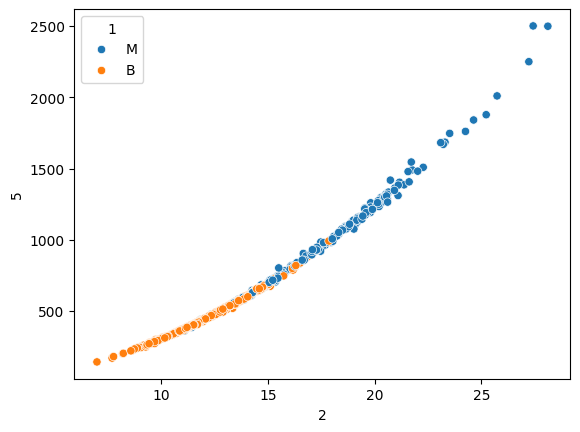

In [20]:
sns.scatterplot(x=wdbc.columns[1], y=wdbc.columns[4], hue=wdbc.columns[0], data=wdbc)

We visualize the correlation matrix as a heat map:

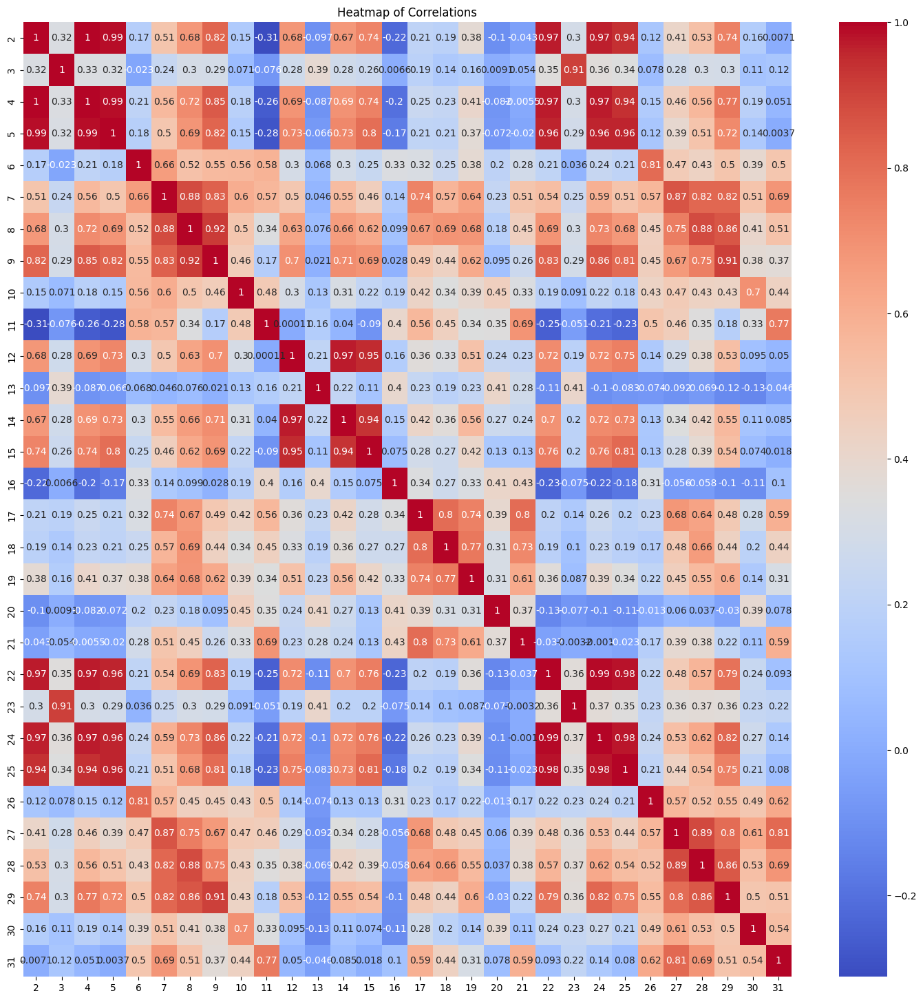

In [21]:
correlation_matrix = wdbc.corr(numeric_only=True)

plt.figure(figsize=(18, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Heatmap of Correlations')
plt.show()

##Titanic dataset
Next we will load the Titanic data set:

In [22]:
url = 'https://raw.githubusercontent.com/AbrahamOtero/MLiB/main/datasets/titanic.csv'

titanic = pd.read_csv(url)
print(titanic.head())
titanic.info()

   PassengerId  Survived  Pclass  \
0            1         0       3   
1            2         1       1   
2            3         1       3   
3            4         1       1   
4            5         0       3   

                                                Name     Sex   Age  SibSp  \
0                            Braund, Mr. Owen Harris    male  22.0      1   
1  Cumings, Mrs. John Bradley (Florence Briggs Th...  female  38.0      1   
2                             Heikkinen, Miss. Laina  female  26.0      0   
3       Futrelle, Mrs. Jacques Heath (Lily May Peel)  female  35.0      1   
4                           Allen, Mr. William Henry    male  35.0      0   

   Parch            Ticket     Fare Cabin Embarked  
0      0         A/5 21171   7.2500   NaN        S  
1      0          PC 17599  71.2833   C85        C  
2      0  STON/O2. 3101282   7.9250   NaN        S  
3      0            113803  53.1000  C123        S  
4      0            373450   8.0500   NaN        S  
<c

We will remove the columns containing the passenger name and unique ID as they are not useful for analytical purposes. We will also remove the ticket number as it is also a unique identifier.

In [23]:
titanic = titanic.drop(['PassengerId', 'Name', 'Ticket'], axis=1)
print(titanic.head())



   Survived  Pclass     Sex   Age  SibSp  Parch     Fare Cabin Embarked
0         0       3    male  22.0      1      0   7.2500   NaN        S
1         1       1  female  38.0      1      0  71.2833   C85        C
2         1       3  female  26.0      0      0   7.9250   NaN        S
3         1       1  female  35.0      1      0  53.1000  C123        S
4         0       3    male  35.0      0      0   8.0500   NaN        S


We shall convert those nominal variables into integers and add a small random number so that we can visualize all the instances in the scatter plots.

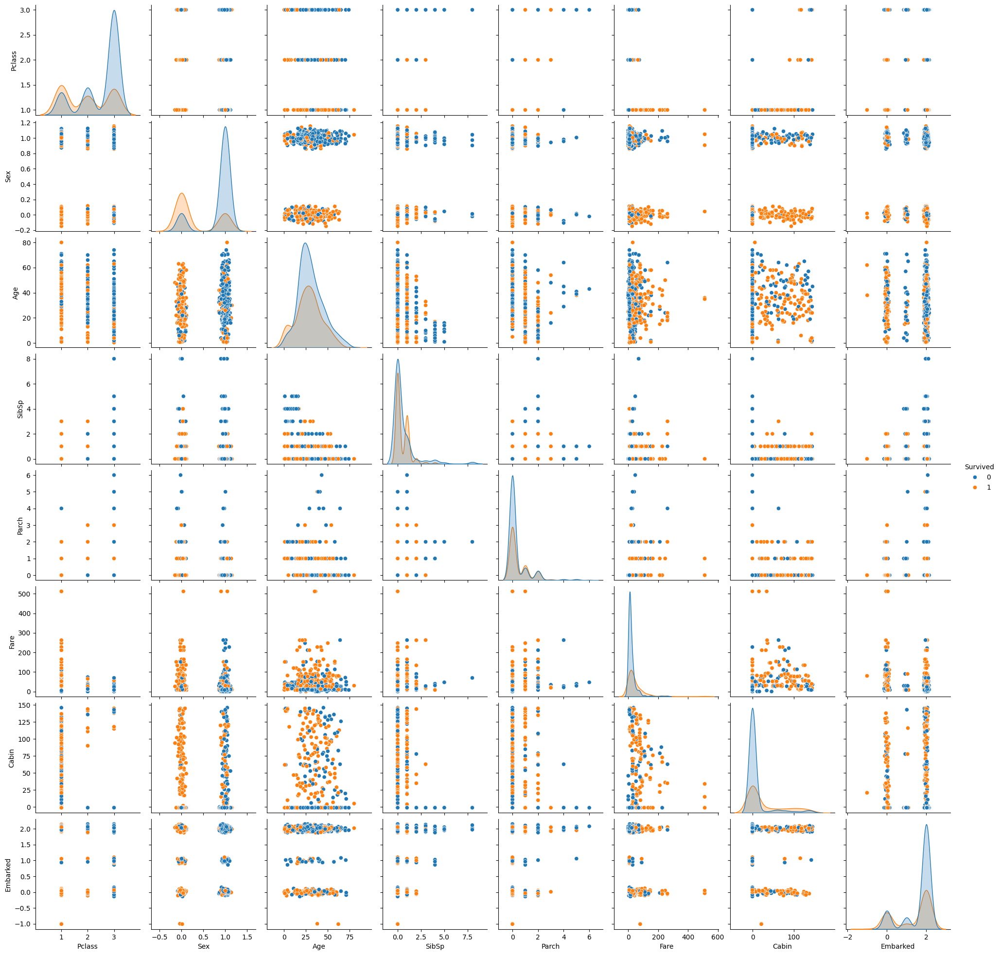

In [24]:
titanic_scatter = titanic.copy()
for col in titanic_scatter.select_dtypes(include=['object']):
    titanic_scatter[col] = titanic_scatter[col].astype('category').cat.codes
    titanic_scatter[col] = titanic_scatter[col] + np.random.normal(0, 0.05, titanic_scatter[col].shape)

# Restore the class as a nomial value
titanic_scatter['Survived'] = titanic['Survived']
# Create scatterplot matrix
sns.pairplot(titanic_scatter, hue='Survived', diag_kind='kde')
plt.show()


This data set contains some missing values; let's see which variables have missing values ​​and how many

In [25]:
# Check for missing values in the Titanic dataset
titanic.isnull().sum()


,0
Survived,0
Pclass,0
Sex,0
Age,177
SibSp,0
Parch,0
Fare,0
Cabin,687
Embarked,2
